In [1]:
import matplotlib.pyplot as plt
import numpy as np
from dysts.flows import Lorenz

In [2]:
sys = Lorenz()
traj = sys.make_trajectory(1024)

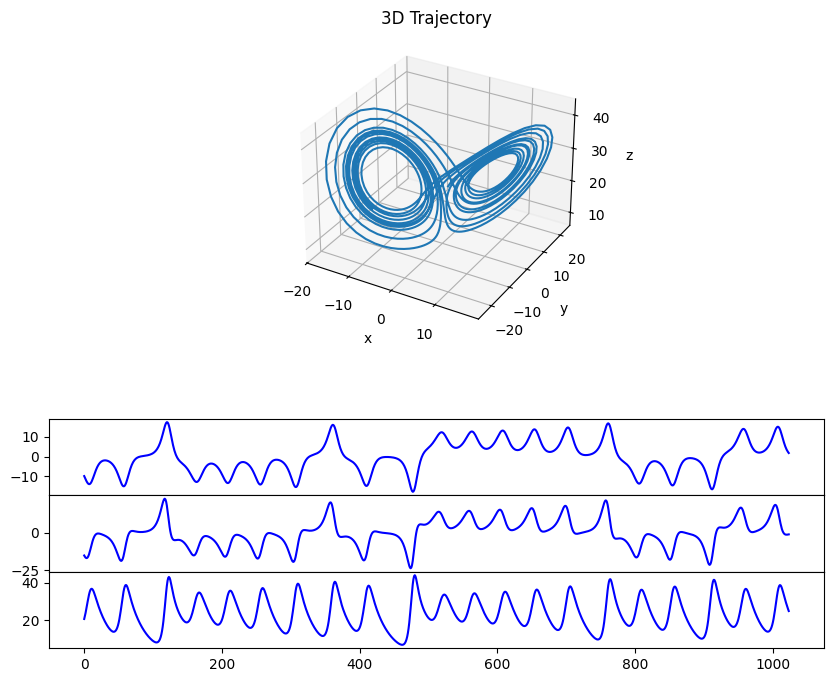

In [3]:
def plot_trajectory_with_coords(traj: np.ndarray, clip: float = None) -> None:
    """Plot 3D trajectory and individual coordinates.

    Args:
        traj: Trajectory array of shape (T, 3)
        clip: Optional float to clamp trajectory values between [-clip, clip]
    """
    fig = plt.figure(figsize=(10, 8))
    gs = fig.add_gridspec(2, 1, height_ratios=[4, 3], hspace=0.3)

    ax1 = fig.add_subplot(gs[0], projection="3d")
    ax1.plot(traj[:, 0], traj[:, 1], traj[:, 2])
    ax1.set_xlabel("x")
    ax1.set_ylabel("y")
    ax1.set_zlabel("z")
    ax1.set_title("3D Trajectory")

    # Bottom row - individual coordinates with shared x axis
    t = np.arange(len(traj))
    gs_bot = gs[1].subgridspec(3, 1, hspace=0)
    axes = []

    # For each coordinate, plot full range and clipped version if clip provided
    for i, (ax, label) in enumerate(
        [(gs_bot[0], "x"), (gs_bot[1], "y"), (gs_bot[2], "z")]
    ):
        ax_i = fig.add_subplot(ax, sharex=axes[0] if i > 0 and axes else None)
        axes.append(ax_i)
        coord = traj[:, i]
        ax_i.plot(t, coord, color="blue")


plot_trajectory_with_coords(traj)

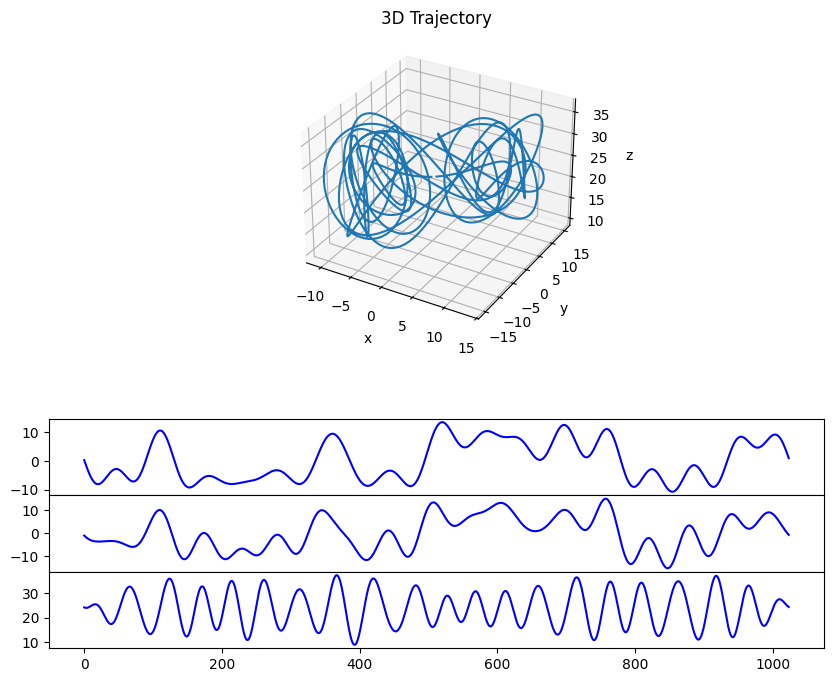

In [4]:
def reconstruct_from_top_k_modes(traj: np.ndarray, k: int) -> np.ndarray:
    """Reconstruct signal from top k Fourier modes.

    Args:
        traj: Trajectory array of shape (T, 3)
        k: Number of modes to keep

    Returns:
        Reconstructed trajectory array of shape (T, 3)
    """
    # Vectorized FFT across all coordinates
    ffts = np.fft.rfft(traj, axis=0)  # Shape: (n_freqs, 3)

    # Get indices of top k modes by magnitude
    magnitudes = np.abs(ffts)
    top_k_indices = np.argsort(magnitudes, axis=0)[-k:, :]  # Shape: (k, 3)

    # Zero out all but top k modes
    filtered_ffts = np.zeros_like(ffts)
    for i in range(3):
        filtered_ffts[top_k_indices[:, i], i] = ffts[top_k_indices[:, i], i]

    # Vectorized inverse transform
    reconstructed = np.fft.irfft(filtered_ffts, len(traj), axis=0)

    return reconstructed


reconstructed = reconstruct_from_top_k_modes(traj, 10)
plot_trajectory_with_coords(reconstructed)


In [5]:
def animate_fourier_reconstruction(traj: np.ndarray, max_k: int = 100) -> None:
    """Animate reconstruction of trajectory with increasing Fourier modes.

    Args:
        traj: Trajectory array of shape (T, 3)
        max_k: Maximum number of modes to show
    """
    fig = plt.figure(figsize=(10, 8))
    gs = fig.add_gridspec(2, 1, height_ratios=[4, 3], hspace=0.3)

    ax3d = fig.add_subplot(gs[0], projection="3d")
    gs_bot = gs[1].subgridspec(3, 1, hspace=0)
    axes = [fig.add_subplot(gs_bot[i]) for i in range(3)]

    t = np.arange(len(traj))
    lines_3d = [ax3d.plot([], [], [], label=f"k={1}")[0]]
    lines_coords = [
        [
            ax.plot([], [], label="Original")[0],
            ax.plot([], [], label="Reconstructed")[0],
        ]
        for ax in axes
    ]

    ax3d.plot(traj[:, 0], traj[:, 1], traj[:, 2], alpha=0.3, color="gray")
    for i, ax in enumerate(axes):
        ax.plot(t, traj[:, i], alpha=0.3, color="gray")

    def init():
        lines_3d[0].set_data([], [])
        lines_3d[0].set_3d_properties([])
        for lines in lines_coords:
            for line in lines:
                line.set_data([], [])
        return lines_3d + [line for lines in lines_coords for line in lines]

    def update(k):
        reconstructed = reconstruct_from_top_k_modes(traj, k + 1)

        lines_3d[0].set_data(reconstructed[:, 0], reconstructed[:, 1])
        lines_3d[0].set_3d_properties(reconstructed[:, 2])
        lines_3d[0].set_label(f"k={k + 1}")

        for i, lines in enumerate(lines_coords):
            lines[1].set_data(t, reconstructed[:, i])

        ax3d.set_title(f"Reconstruction with {k + 1} modes")
        ax3d.legend()

        return lines_3d + [line for lines in lines_coords for line in lines]

    from matplotlib.animation import FuncAnimation

    anim = FuncAnimation(
        fig, update, frames=max_k, init_func=init, interval=200, blit=True
    )

    for i, (ax, label) in enumerate(zip(axes, ["x", "y", "z"])):
        ax.set_ylabel(label)
        if i < 2:
            ax.set_xticks([])
    axes[-1].set_xlabel("Time")

    plt.close()
    return anim


# Create and display animation
anim = animate_fourier_reconstruction(traj)
from IPython.display import HTML

anim.save("fourier.gif")
HTML(anim.to_jshtml())

MovieWriter ffmpeg unavailable; using Pillow instead.


Animation size has reached 21005309 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
